# Illustration of WGANs' Critic's output distribution while training

This notebook illustrates the output distributions of the Critic when using different training iterations of Critic and Generator.

 Implementation is influenced from the assignments given in the [GAN specialization on Coursera](https://www.coursera.org/specializations/generative-adversarial-networks-gans?)

* WANDB project name : 'test3: illustration'
* WANDB project link : https://wandb.ai/hobby_projects/WGAN_implementation?workspace=user-hobby_projects


In [ ]:
import torch
import numpy as np
from torch import nn
from torchsummary import summary
import torchvision
from torchvision import datasets
from torchvision import transforms
import matplotlib.pyplot as plt

device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')

##1. Download the Dataset (CelebA)

In [ ]:
import zipfile
import os
if not os.path.isfile('celeba.zip'):
  !mkdir data_faces && wget https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip 
  with zipfile.ZipFile("celeba.zip","r") as zip_ref:
    zip_ref.extractall("data_faces/")

--2021-01-19 16:16:52--  https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip
Resolving s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)... 52.219.120.176
Connecting to s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)|52.219.120.176|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1443490838 (1.3G) [application/zip]
Saving to: ‘celeba.zip’

celeba.zip          100%[===================>]   1.34G  42.3MB/s    in 33s     

2021-01-19 16:17:25 (41.5 MB/s) - ‘celeba.zip’ saved [1443490838/1443490838]



##2. Define Parameters

In [ ]:
lr=0.0002
noise_channels=256
img_channels=3
img_size=64
hidden_G=16
hidden_C=16
batch_size=128
epochs=10

##3. Preparing the Dataset

In [ ]:
from torch.utils.data import DataLoader

transform = transforms.Compose([
                               transforms.Resize((img_size,img_size)),
                               transforms.ToTensor(),
                                transforms.Normalize((0.5,0.5, 0.5),(0.5, 0.5, 0.5))])

dataset = datasets.ImageFolder('data_faces', transform=transform)
data_loader = DataLoader(dataset,batch_size=batch_size,shuffle=True)

##4. Defining Support Blocks


In [ ]:
class conv_trans_block(nn.Module):
  def __init__(self,in_channels,out_channels,kernal_size=4,stride=2,padding=1):
    super(conv_trans_block,self).__init__()
    self.block=nn.Sequential(
        nn.ConvTranspose2d(in_channels,out_channels,kernal_size,stride,padding),
        nn.BatchNorm2d(out_channels),
        nn.ReLU())
  def forward(self,x):
    return self.block(x)

class conv_block(nn.Module):
  def __init__(self,in_channels,out_channels,kernal_size=4,stride=2,padding=1):
    super(conv_block,self).__init__()
    self.block=nn.Sequential(
        nn.Conv2d(in_channels,out_channels,kernal_size,stride,padding),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.2))
  def forward(self,x):
    return self.block(x)

##5. Defining Generator and Discriminator

In [ ]:
class Generator(nn.Module):
  def __init__(self,noise_channels,img_channels,hidden_G):
    super(Generator,self).__init__()
    self.G=nn.Sequential(
        conv_trans_block(noise_channels,hidden_G*16,kernal_size=4,stride=1,padding=0),
        conv_trans_block(hidden_G*16,hidden_G*8),
        conv_trans_block(hidden_G*8,hidden_G*4),
        conv_trans_block(hidden_G*4,hidden_G*2),
        nn.ConvTranspose2d(hidden_G*2,img_channels,kernel_size=4,stride=2,padding=1),
        nn.Tanh()
    )
  def forward(self,x):
    return self.G(x)

class Critic(nn.Module):
  def __init__(self,img_channels,hidden_D):
    super(Critic,self).__init__()
    self.D=nn.Sequential(
        conv_block(img_channels,hidden_G),
        conv_block(hidden_G,hidden_G*2),
        conv_block(hidden_G*2,hidden_G*4),
        conv_block(hidden_G*4,hidden_G*8),
        nn.Conv2d(hidden_G*8,1,kernel_size=4,stride=2,padding=0))
    
  def forward(self,x):
    return self.D(x)

##6. Creating the GAN


1.   Create Discriminator and the Generator
2.   Select **Binary Cross Entropy** as the Loss (which can be used as the losses of both Generator and Discriminator)
3.   Select **Adam** optimizer as optimizers for both Generator and Discriminator

Model architectures can be seen below

In [ ]:
C=Critic(img_channels,hidden_C).to(device)
G=Generator(noise_channels,img_channels,hidden_G).to(device)

print('Critic :')
summary(C,(img_channels,img_size,img_size))
print('Generator :')
summary(G,(noise_channels,1,1))

opt_C=torch.optim.Adam(C.parameters(),lr=lr, betas=(0.5,0.999))
opt_G=torch.optim.Adam(G.parameters(),lr=lr, betas=(0.5,0.999))

Critic :
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 32, 32]             784
       BatchNorm2d-2           [-1, 16, 32, 32]              32
         LeakyReLU-3           [-1, 16, 32, 32]               0
        conv_block-4           [-1, 16, 32, 32]               0
            Conv2d-5           [-1, 32, 16, 16]           8,224
       BatchNorm2d-6           [-1, 32, 16, 16]              64
         LeakyReLU-7           [-1, 32, 16, 16]               0
        conv_block-8           [-1, 32, 16, 16]               0
            Conv2d-9             [-1, 64, 8, 8]          32,832
      BatchNorm2d-10             [-1, 64, 8, 8]             128
        LeakyReLU-11             [-1, 64, 8, 8]               0
       conv_block-12             [-1, 64, 8, 8]               0
           Conv2d-13            [-1, 128, 4, 4]         131,200
      BatchNorm2d-14          

##7. Training and Generating Images

In [ ]:
import os

try:os.mkdir('latest_model')
except:pass

In [ ]:
def init_weights(m):
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)

def get_gradient(crit, real_imgs, fake_imgs, epsilon):

  mixed_imgs= real_imgs* epsilon + fake_imgs*(1- epsilon)
  mixed_scores= crit(mixed_imgs)

  gradient= torch.autograd.grad(outputs= mixed_scores,
                                inputs= mixed_imgs,
                                grad_outputs= torch.ones_like(mixed_scores),
                                create_graph=True,
                                retain_graph=True)[0]
  return gradient

def gradient_penalty(gradient):
  gradient= gradient.view(len(gradient), -1)
  gradient_norm= gradient.norm(2, dim=1)
  penalty = torch.nn.MSELoss()(gradient_norm, torch.ones_like(gradient_norm))
  return penalty

def get_gen_loss(crit_fake_pred):
  gen_loss= -torch.mean(crit_fake_pred)
  return gen_loss

def get_crit_loss(crit_fake_pred, crit_real_pred, gradient_penalty, c_lambda):
  crit_loss= torch.mean(crit_fake_pred)- torch.mean(crit_real_pred)+ c_lambda* gradient_penalty
  return crit_loss

In [ ]:
!!pip install wandb -qqq

import wandb
wandb.login()
def save_model_as_checkpoint_wfdb(epoch, model, optimizer, loss, path, run, artifact):
    torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': loss,
                }, path)

    artifact.add_file(path)
    run.log_artifact(artifact)


<IPython.core.display.Javascript object>

wandb: You can find your API key in your browser here: https://wandb.ai/authorize


wandb: Paste an API key from your profile and hit enter: ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
import seaborn as sns
def get_distributions(real_C_out, fake_C_out, name):
  real_C_out = real_C_out.view(-1,).detach().cpu().numpy()
  fake_C_out = fake_C_out.view(-1,).detach().cpu().numpy()

  sns.kdeplot(real_C_out, label='for real images')
  sns.kdeplot(fake_C_out, label='for fake images')
  plt.title(name)
  plt.legend()

  return plt


In [ ]:
name='test3: illustration'
run=wandb.init(project='WGAN_implementation' , name=name)
#run=wandb.init(project='check' , name=name)

wandb: Currently logged in as: hobby_projects (use `wandb login --relogin` to force relogin)


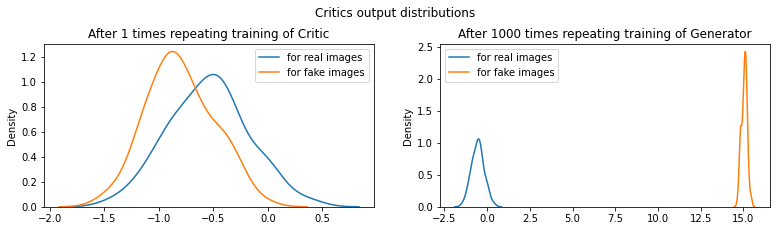

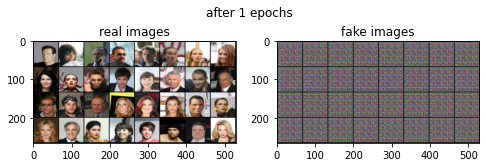

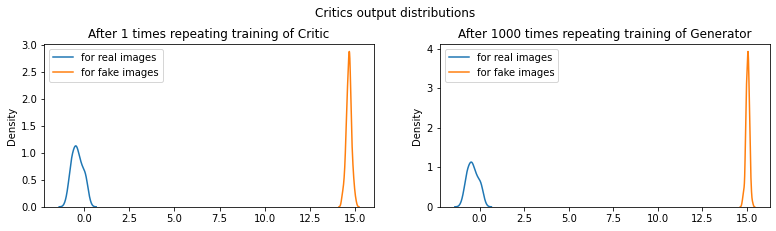

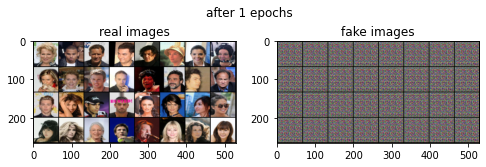

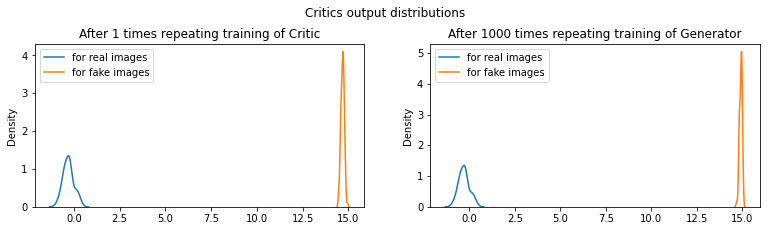

...

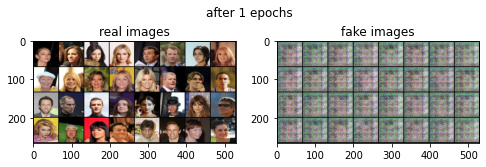

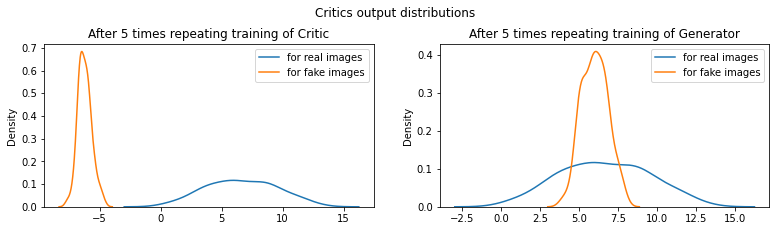

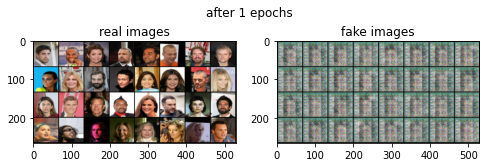

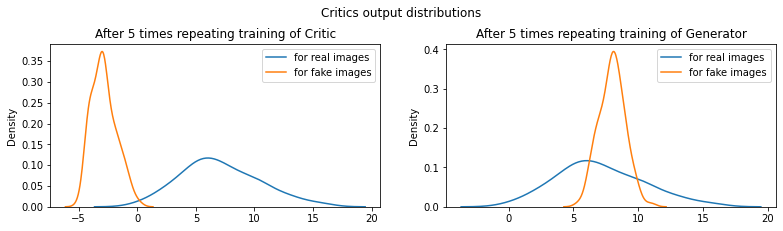

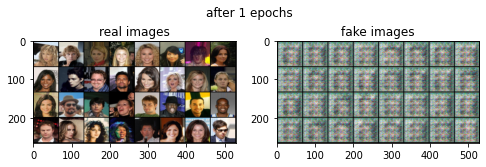

In [ ]:
repeats_comb=[[1000,1],[1, 1000],[1,1],[1000, 1000], [5, 1], [1, 5], [5, 5]]
noise_for_generate=torch.randn(batch_size,noise_channels,1,1).to(device)

for repeats in repeats_comb:
  C=Critic(img_channels,hidden_C).to(device)
  G=Generator(noise_channels,img_channels,hidden_G).to(device)

  #C=C.apply(init_weights)
  #G=G.apply(init_weights)

  wandb.watch(G, log='all', log_freq=10)
  wandb.watch(C, log='all', log_freq=10)

  opt_C=torch.optim.Adam(C.parameters(),lr=lr, betas=(0.5,0.999))
  opt_G=torch.optim.Adam(G.parameters(),lr=lr, betas=(0.5,0.999))

  gen_repeats, crit_repeats= repeats
  
  epochs=1
  for epoch in range(1,epochs+1):
    loss_C_epoch=[]
    loss_G_epoch=[]

    for idx,(x,_) in enumerate(data_loader):
      C.train()
      G.train()

      x=x.to(device)
      x_len=x.shape[0]

      ### Train C

      loss_C_iter=0
      for _ in range(crit_repeats):
        opt_C.zero_grad()
        z=torch.randn(x_len,noise_channels,1,1).to(device)

        real_imgs=x
        fake_imgs=G(z).detach()

        real_C_out=C(real_imgs)
        fake_C_out=C(fake_imgs)

        epsilon= torch.rand(len(x),1,1,1, device= device, requires_grad=True)
        gradient= get_gradient(C, real_imgs, fake_imgs.detach(), epsilon)
        gp= gradient_penalty(gradient)
        loss_C= get_crit_loss(fake_C_out, real_C_out, gp, c_lambda=10)

        loss_C.backward()
        opt_C.step()

      plt.figure(figsize=(13,3))
      plt.subplot(1,2,1)
      z=torch.randn(x_len,noise_channels,1,1).to(device)
      plt=get_distributions(C(real_imgs), C(G(z)), f'After {crit_repeats} times repeating training of Critic')
      #plt.xlim([-5, 20])

      ### Train G
      loss_G_iter=0
      for _ in range(gen_repeats):
        opt_G.zero_grad()
        z=torch.randn(x_len,noise_channels,1,1).to(device)
        fake_C_out = C(G(z))
        loss_G= get_gen_loss(fake_C_out)
        loss_G.backward()
        opt_G.step()

      plt.subplot(1,2,2)
      z=torch.randn(x_len,noise_channels,1,1).to(device)
      plt=get_distributions(C(real_imgs), C(G(z)), f'After {gen_repeats} times repeating training of Generator')
      #plt.xlim([-5, 20])

      plt.suptitle('Critics output distributions', y=1.05)

      #wandb.log({f"{name} : Critics output distributions :: gen_repeats : {gen_repeats} crit_repeats : {crit_repeats}, idx : {idx}": plt})
      wandb.log({f"{name} : Critics output distributions :: gen_repeats : {gen_repeats} crit_repeats : {crit_repeats}, idx : {idx}": [wandb.Image(plt, caption="Critics output distributions")]})

      plt.show()

      ## show images
      G.eval()
      generated=G(noise_for_generate).detach()
      img_grid_real=torchvision.utils.make_grid(x[:32]*0.5+0.5).permute(1,2,0).squeeze().cpu()
      img_grid_fake=torchvision.utils.make_grid(generated[:32]*0.5+0.5).permute(1,2,0).squeeze().cpu()

      plt.figure(figsize=(8,4))
      plt.subplot(1,2,1)
      plt.imshow(img_grid_real)
      plt.title('real images')
      plt.subplot(1,2,2)
      plt.imshow(img_grid_fake)
      plt.title('fake images')
      plt.suptitle(f'after {epoch} epochs', y=0.8)
      wandb.log({f"{name} : output images :: gen_repeats : {gen_repeats} crit_repeats : {crit_repeats}, idx : {idx}": plt})
      #plt.clf()
      plt.show()

      if idx==25:
        break